In [1]:
def compare_distributions(df, healthy_status, tissue):
    """
    Compare the distributions of a specific tissue between healthy and diseased samples.
    
    Parameters:
        df (pd.DataFrame): DataFrame containing the data.
        healthy_status (str): Value in 'disease_status' indicating healthy samples.
        tissue (str): Column name of the tissue to compare.
    
    Returns:
        str: Summary of the statistical test results.
    """
    # Filter for healthy and diseased samples
    healthy_samples = df[df['disease_status'] == healthy_status][tissue]
    diseased_samples = df[df['disease_status'] != healthy_status][tissue]
    
    # Check normality
    healthy_normality = shapiro(healthy_samples)
    diseased_normality = shapiro(diseased_samples)
    print(f"Healthy samples normality test: {healthy_normality.statistic:.3f} with p-value {healthy_normality.pvalue:.3f}")
    print(f"Diseased samples normality test: {diseased_normality.statistic:.3f} with p-value {diseased_normality.pvalue:.3f}")
    
    # Choose the appropriate test
    if healthy_normality.pvalue > 0.05 and diseased_normality.pvalue > 0.05:
        # Both distributions are normal; use t-test
        stat, p_value = ttest_ind(healthy_samples, diseased_samples, equal_var=False)
        test_name = "T-Test"
    else:
        # Non-parametric test
        stat, p_value = mannwhitneyu(healthy_samples, diseased_samples)
        test_name = "Mann-Whitney U Test"
    
    # Print results
    significance = "Significant difference" if p_value < 0.05 else "No significant difference"
    print(f"{test_name} Results:")
    print(f"Statistic: {stat:.3f}, P-value: {p_value:.3f}")
    print(significance)
    
    return f"{test_name}: Statistic={stat:.3f}, P-value={p_value:.3f}, {significance}"

#remove mlmarker.log file
import os
if os.path.exists("MLMarker.log"):
    os.remove("MLMarker.log")
    print('removed MLMarker.log')


from scipy.stats import ttest_ind, mannwhitneyu
from scipy.stats import shapiro
import sys
sys.modules.pop("mlmarker", None)

import mlmarker
print(mlmarker.__file__)
import mlmarker.model as MLMarker
import os
import sys
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(style="whitegrid")

# import pyteomics
# from pyteomics import auxiliary as aux
pd.options.mode.chained_assignment = None

import tqdm
sys.path.append('/home/compomics/git/Projects/MLMarker_paper')
from MLMarker_reprocessing_quant import *

#import umap
import umap
import matplotlib.patches as mpatches

removed MLMarker.log


IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html


/home/compomics/miniconda3/envs/mlmarker/lib/python3.10/site-packages/mlmarker/__init__.py


Trying to unpickle estimator DecisionTreeClassifier from version 1.5.1 when using version 1.6.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
Trying to unpickle estimator RandomForestClassifier from version 1.5.1 when using version 1.6.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations


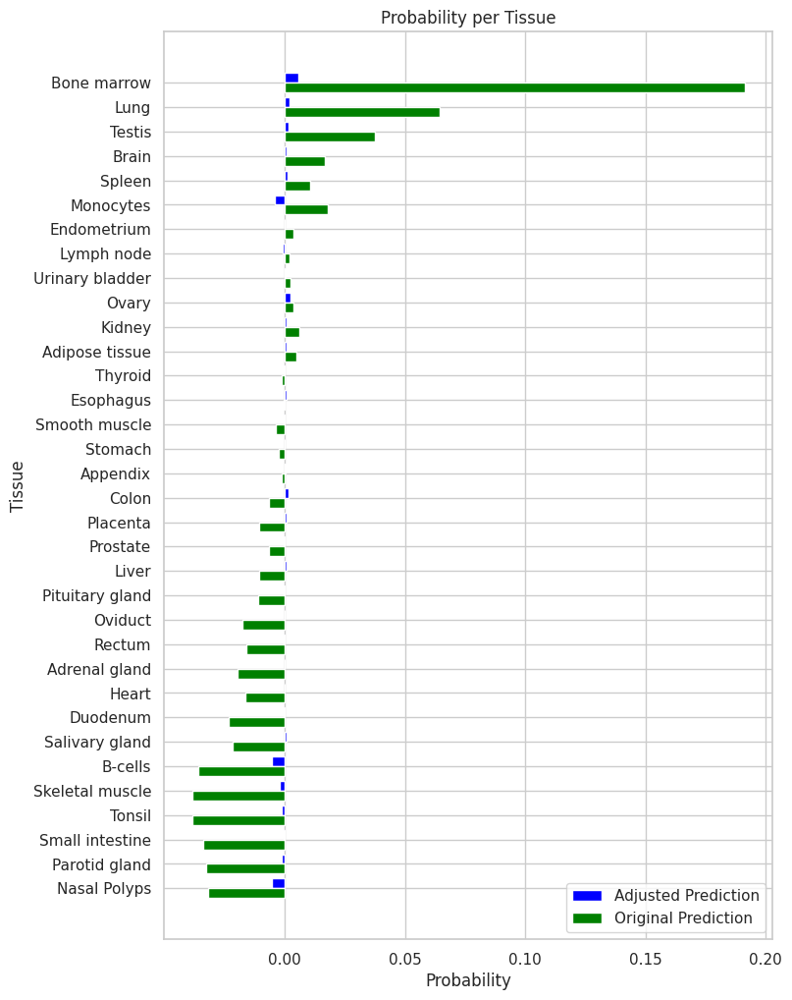

In [2]:
model = mlmarker.MLMarker(dev=True, binary=False, penalty_factor=1)
feats = model.get_model_features()
#create a sample with the features as column names and one row containing all zero
zero_sample = pd.DataFrame(0, index=[0], columns=feats)
model.load_sample(zero_sample.iloc[0:1,:])
prediction_adj = model.explainability.adjusted_absent_shap_values_df(n_preds=100).sum(axis=1)
prediction = model.explainability.shap_values_df(n_preds=100).sum(axis=1)
# Grouped barplot
width =0.8  # Increase the width of the bars

spacing =1  # Space between tissue groups

# Define y positions with added spacing
x = np.arange(len(prediction_adj.index)) * (1 + spacing)

fig, ax = plt.subplots(figsize=(8, 12))
rects1 = ax.barh(x, prediction_adj, height=width, label='Adjusted Prediction', color='blue')  # Set the color for the adjusted prediction bars
rects2 = ax.barh(x+width, prediction, height=width, label='Original Prediction', color='green')  # Set the color for the original prediction bars

ax.set_ylabel('Tissue')
ax.set_xlabel('Probability')
ax.set_title('Probability per Tissue')

ax.set_yticks(x + width / 2)
ax.set_yticklabels(prediction_adj.index)
ax.legend()

ax.invert_yaxis()  # Invert the y-axis

plt.show()
# fig.savefig("/home/compomics/git/Projects/MLMarker_paper/Figures_paper/CSF_penaltyfactor.png", dpi=800, bbox_inches= "tight")

In [3]:
#CSF
pxd = "PXD008029"
base_path = f"/home/compomics/conode*/PRIDE_DATA/"  
lengths_path = "/home/compomics/git/Projects/MLMarker_paper/uniprot_reviewed_lengths.tsv"
mlmarker_df, unique_proteins_dict, psm_dict = get_mlmarker_dataframe(pxd, base_path, lengths_path, dev=True, tissue_level=True, count_psms=True)
mlmarker_df.iloc[:,:-2] = mlmarker_df.iloc[:,:-2].clip(lower=0)
mlmarker_df.head()

Trying to unpickle estimator DecisionTreeClassifier from version 1.5.1 when using version 1.6.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
Trying to unpickle estimator RandomForestClassifier from version 1.5.1 when using version 1.6.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
Trying to unpickle estimator DecisionTreeClassifier from version 1.5.1 when using version 1.6.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
Trying to unpickle estimator RandomForestClassifier from version 1.5.1 when using version 1.6.1. This might lead to

Trying to unpickle estimator DecisionTreeClassifier from version 1.5.1 when using version 1.6.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
Trying to unpickle estimator RandomForestClassifier from version 1.5.1 when using version 1.6.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
Trying to unpickle estimator DecisionTreeClassifier from version 1.5.1 when using version 1.6.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
Trying to unpickle estimator RandomForestClassifier from version 1.5.1 when using version 1.6.1. This might lead to

tissue,Pituitary gland,Thyroid,Endometrium,Prostate,Adrenal gland,Stomach,Monocytes,Colon,Kidney,Salivary gland,...,Appendix,Esophagus,Brain,Adipose tissue,Lymph node,Lung,Testis,Bone marrow,PXD_folder,filename
0,0.08046,0.05959,0.00764,0.00726,0.00703,0.00700,0.00607,0.00402,0.00311,0.00225,...,0.00000,0.0,0.00000,0.00000,0.00000,0.0,0.0,0.00000,PXD008029,CSF_OGE_Fraction_08_01.mgf.gzip
0,0.00000,0.00000,0.00000,0.00000,0.00000,0.00062,0.00000,0.00499,0.00726,0.00108,...,0.01164,0.0,0.00000,0.06981,0.00089,0.0,0.0,0.00000,PXD008029,Plasma_OGE_Fraction_14_02Jupiter.mgf.gzip
0,0.17534,0.01336,0.00000,0.00000,0.04150,0.00596,0.00000,0.00000,0.00000,0.00138,...,0.00000,0.0,0.14209,0.00000,0.00000,0.0,0.0,0.00000,PXD008029,CSF_OGE_Fracction_02_02Jupiter.mgf.gzip
0,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.03887,0.00897,0.00000,0.00061,...,0.01211,0.0,0.00000,0.04827,0.00067,0.0,0.0,0.00000,PXD008029,Plasma_OGE_Fraction_07_02(Jupiter).mgf.gzip
0,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.02211,0.00318,0.00000,0.00027,...,0.00345,0.0,0.07202,0.04285,0.00000,0.0,0.0,0.00483,PXD008029,Plasma_OGE_Fraction_04_02(Jupiter).mgf.gzip


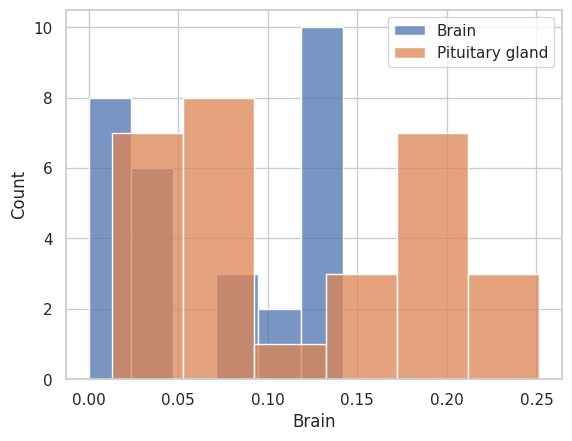

In [4]:
mlmarker_df['type'] = mlmarker_df['filename'].str.split('_').str[0]
mlmarker_df['fraction_number'] = mlmarker_df['filename'].str.split('_').str[3].astype(int)

sns.histplot(data=mlmarker_df[mlmarker_df['type'] == 'CSF'], x='Brain')
sns.histplot(data=mlmarker_df[mlmarker_df['type'] == 'CSF'], x='Pituitary gland')

plt.legend(labels=['Brain', 'Pituitary gland'])


In [5]:
#read number of remaining fetures per sample 
logoutput = {'CSF_OGE_Fraction_08_01.mgf.gzip' : {'added':5906, 'removed': 69, 'remaining': 73},
'Plasma_OGE_Fraction_14_02Jupiter.mgf.gzip' : {'added':5953, 'removed': 13, 'remaining': 26},
'CSF_OGE_Fracction_02_02Jupiter.mgf.gzip' : {'added':5906, 'removed': 56, 'remaining': 73},
'Plasma_OGE_Fraction_07_02(Jupiter).mgf.gzip' : {'added':947, 'removed': 14, 'remaining': 32},
'Plasma_OGE_Fraction_04_02(Jupiter).mgf.gzip' : {'added':924, 'removed': 30, 'remaining': 55},
'CSF_OGE_Fracction_05_02Jupiter.mgf.gzip' : {'added':5919, 'removed': 43, 'remaining': 60},
'CSF_OGE_Fracction_22_02Jupiter.mgf.gzip' : {'added':5900, 'removed': 50, 'remaining': 79},
'Plasma_OGE_Fraction_16_02Jupiter.mgf.gzip' : {'added':5943, 'removed': 16, 'remaining': 36},
'Plasma_OGE_Fraction_08_02(Jupiter).mgf.gzip' : {'added':922, 'removed': 33, 'remaining': 57},
'CSF_OGE_Fracction_03_02Jupiter.mgf.gzip' : {'added':5890, 'removed': 65, 'remaining': 89},
'CSF_OGE_Fracction_04_02Jupiter.mgf.gzip' : {'added':5902, 'removed': 53, 'remaining': 77},
'Plasma_OGE_Fraction_03_02Jupiter.mgf.gzip' : {'added':5902, 'removed': 38, 'remaining': 77},
'CSF_OGE_Fracction_06_02Jupiter.mgf.gzip' : {'added':5966, 'removed': 6, 'remaining': 13},
'Plasma_OGE_Fraction_01_02Jupiter.mgf.gzip' : {'added':5945, 'removed': 14, 'remaining': 34},
'CSF_OGE_Fracction_06_02(Jupiter).mgf.gzip' : {'added':5971, 'removed': 7, 'remaining': 8},
'CSF_OGE_Fracction_05_02(Jupiter).mgf.gzip' : {'added':5904, 'removed': 50, 'remaining': 75},
'CSF_OGE_Fracction_08_02Jupiter.mgf.gzip' : {'added':5887, 'removed': 92, 'remaining': 92},
'CSF_OGE_Fracction_08_02(Jupiter).mgf.gzip' : {'added':5874, 'removed': 102,' remaining': 15},
'Plasma_OGE_Fraction_01_02(Jupiter).mgf.gzip' : {'added':934, 'removed': 26, 'remaining': 45},
'CSF_OGE_Fracction_21_02Jupiter.mgf.gzip' : {'added':5936, 'removed': 22, 'remaining': 43},
'Plasma_OGE_Fraction_14_02(Jupiter).mgf.gzip' : {'added':950, 'removed': 13, 'remaining': 29},
'CSF_OGE_Fracction_10_02Jupiter.mgf.gzip' : {'added':5894, 'removed': 76, 'remaining': 85},
'Plasma_OGE_Fraction_16_02(Jupiter).mgf.gzip' : {'added':943, 'removed': 13, 'remaining': 36},
'CSF_OGE_Fracction_09_02(Jupiter).mgf.gzip' : {'added':5863, 'removed': 104,' remaining': 16},
'Plasma_OGE_Fraction_15_02Jupiter.mgf.gzip' : {'added':5950, 'removed': 11, 'remaining': 29},
'CSF_OGE_Fracction_04_02(Jupiter).mgf.gzip' : {'added':5867, 'removed': 83, 'remaining': 11},
'CSF_OGE_Fracction_23_02Jupiter.mgf.gzip' : {'added':5898, 'removed': 56, 'remaining': 81},
'Plasma_OGE_Fraction_21_02Jupiter.mgf.gzip' : {'added':5947, 'removed': 13, 'remaining': 32},
'Plasma_OGE_Fraction_17_02Jupiter.mgf.gzip' : {'added':5944, 'removed': 17, 'remaining': 35},
'CSF_OGE_Fracction_16_02(Jupiter).mgf.gzip' : {'added':5948, 'removed': 31, 'remaining': 31},
'CSF_OGE_Fracction_19_02Jupiter.mgf.gzip' : {'added':5948, 'removed': 19, 'remaining': 31},
'CSF_OGE_Fracction_15_02(Jupiter).mgf.gzip' : {'added':5913, 'removed': 45, 'remaining': 66},
'Plasma_OGE_Fraction_02_02Jupiter.mgf.gzip' : {'added':5921, 'removed': 31, 'remaining': 58},
'CSF_OGE_Fraction_09_01.mgf.gzip' : {'added':5873, 'removed': 76, 'remaining': 10},
'Plasma_OGE_Fraction_20_02Jupiter.mgf.gzip' : {'added':5940, 'removed': 15, 'remaining': 39},
'Plasma_OGE_Fraction_09_02(Jupiter).mgf.gzip' : {'added':904, 'removed': 40, 'remaining': 75},
'CSF_OGE_Fracction_10_02(Jupiter).mgf.gzip' : {'added':5864, 'removed': 95, 'remaining': 11},
'Plasma_OGE_Fraction_10_02Jupiter.mgf.gzip' : {'added':5925, 'removed': 20, 'remaining': 54},
'Plasma_OGE_Farction_04_01.mgf.gzip' : {'added':5942, 'removed': 16, 'remaining': 37},
'Plasma_OGE_Fraction_05_02(Jupiter).mgf.gzip' : {'added':929, 'removed': 25, 'remaining': 50},
'Plasma_OGE_Fraction_11_02(Jupiter).mgf.gzip' : {'added':953, 'removed': 12, 'remaining': 26},
'Plasma_OGE_Fraction_03_02(Jupiter).mgf.gzip' : {'added':897, 'removed': 37, 'remaining': 82},
'Plasma_OGE_Fraction_05_02Jupiter.mgf.gzip' : {'added':5929, 'removed': 20, 'remaining': 50},
'CSF_OGE_Fraction_10_01.mgf.gzip' : {'added':5908, 'removed': 55, 'remaining': 71},
'Plasma_OGE_Fraction_17_02(Jupiter).mgf.gzip' : {'added':943, 'removed': 17, 'remaining': 36},
'Plasma_OGE_Fraction_02_02(Jupiter).mgf.gzip' : {'added':922, 'removed': 30, 'remaining': 57},
'CSF_OGE_Fracction_03_02(Jupiter).mgf.gzip' : {'added':5866, 'removed': 89, 'remaining': 11},
'CSF_OGE_Fraction_11_01.mgf.gzip' : {'added':5947, 'removed': 32, 'remaining': 32},
'Plasma_OGE_Fraction_09_02Jupiter.mgf.gzip' : {'added':5918, 'removed': 29, 'remaining': 61},
'Plasma_OGE_Fraction_06_02Jupiter.mgf.gzip' : {'added':5934, 'removed': 23, 'remaining': 45},
'CSF_OGE_Fracction_23_02(Jupiter).mgf.gzip' : {'added':5892, 'removed': 66, 'remaining': 87},
'Plasma_OGE_Fraction_07_02Jupiter.mgf.gzip' : {'added':5943, 'removed': 15, 'remaining': 36},
'Plasma_OGE_Fraction_10_02(Jupiter).mgf.gzip' : {'added':929, 'removed': 16, 'remaining': 50},
'CSF_OGE_Fracction_15_02Jupiter.mgf.gzip' : {'added':5924, 'removed': 38, 'remaining': 55},
'Plasma_OGE_Fraction_08_02Jupiter.mgf.gzip' : {'added':5923, 'removed': 31, 'remaining': 56},
'Plasma_OGE_Fraction_11_02Jupiter.mgf.gzip' : {'added':5953, 'removed': 12, 'remaining': 26},
'Plasma_OGE_Fraction_04_02Jupiter.mgf.gzip' : {'added':5921, 'removed': 37, 'remaining': 58},
'CSF_OGE_Fracction_09_02Jupiter.mgf.gzip' : {'added':5897, 'removed': 82, 'remaining': 82},
'Plasma_OGE_Fraction_15_02(Jupiter).mgf.gzip' : {'added':951, 'removed': 11, 'remaining': 28},
'Plasma_OGE_Fraction_22_02(Jupiter).mgf.gzip' : {'added':952, 'removed': 6, 'remaining': 27},
'CSF_OGE_Fracction_22_02(Jupiter).mgf.gzip' : {'added':5899, 'removed': 53, 'remaining': 80},
'CSF_OGE_Fracction_02_02(Jupiter).mgf.gzip' : {'added':5893, 'removed': 69, 'remaining': 86},
'Plasma_OGE_Fraction_21_02(Jupiter).mgf.gzip' : {'added':956, 'removed': 6, 'remaining': 23},
'Plasma_OGE_Fraction_06_02(Jupiter).mgf.gzip' : {'added':954, 'removed': 12, 'remaining': 25},
'Plasma_OGE_Farction_02_01.mgf.gzip' : {'added':5949, 'removed': 19, 'remaining': 30}}

#read number of remaining fetures per sample
logoutput_df = pd.DataFrame(logoutput).T
logoutput_df['filename'] = logoutput_df.index
logoutput_df['type'] = logoutput_df['filename'].str.split('_').str[0]
logoutput_df

,added,removed,remaining,remaining,filename,type
CSF_OGE_Fraction_08_01.mgf.gzip,5906.0,69.0,73.0,NaN,CSF_OGE_Fraction_08_01.mgf.gzip,CSF
Plasma_OGE_Fraction_14_02Jupiter.mgf.gzip,5953.0,13.0,26.0,NaN,Plasma_OGE_Fraction_14_02Jupiter.mgf.gzip,Plasma
CSF_OGE_Fracction_02_02Jupiter.mgf.gzip,5906.0,56.0,73.0,NaN,CSF_OGE_Fracction_02_02Jupiter.mgf.gzip,CSF
Plasma_OGE_Fraction_07_02(Jupiter).mgf.gzip,947.0,14.0,32.0,NaN,Plasma_OGE_Fraction_07_02(Jupiter).mgf.gzip,Plasma
Plasma_OGE_Fraction_04_02(Jupiter).mgf.gzip,924.0,30.0,55.0,NaN,Plasma_OGE_Fraction_04_02(Jupiter).mgf.gzip,Plasma
...,...,...,...,...,...,...
CSF_OGE_Fracction_22_02(Jupiter).mgf.gzip,5899.0,53.0,80.0,NaN,CSF_OGE_Fracction_22_02(Jupiter).mgf.gzip,CSF
CSF_OGE_Fracction_02_02(Jupiter).mgf.gzip,5893.0,69.0,86.0,NaN,CSF_OGE_Fracction_02_02(Jupiter).mgf.gzip,CSF
Plasma_OGE_Fraction_21_02(Jupiter).mgf.gzip,956.0,6.0,23.0,NaN,Plasma_OGE_Fraction_21_02(Jupiter).mgf.gzip,Plasma
Plasma_OGE_Fraction_06_02(Jupiter).mgf.gzip,954.0,12.0,25.0,NaN,Plasma_OGE_Fraction_06_02(Jupiter).mgf.gzip,Plasma


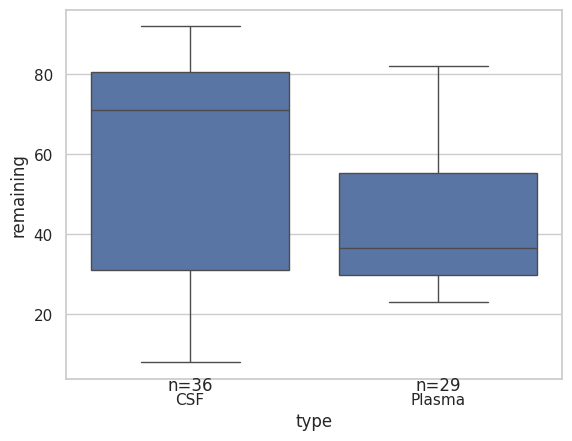

In [6]:
sns.boxplot(data=logoutput_df, x='type', y='remaining')
#add the number of samples to the xaxis label
for i in range(2):
    count = logoutput_df['type'].value_counts().values[i]
    plt.text(i, 0, f"n={count}", ha='center', va='bottom')

                 psm_count  Bone marrow  Adipose tissue  Monocytes  \
psm_count         1.000000     0.243605        0.229020   0.438104   
Bone marrow       0.243605     1.000000       -0.213388   0.387004   
Adipose tissue    0.229020    -0.213388        1.000000  -0.059767   
Monocytes         0.438104     0.387004       -0.059767   1.000000   
fraction_number  -0.647549    -0.192729       -0.495013  -0.418377   

                 fraction_number  
psm_count              -0.647549  
Bone marrow            -0.192729  
Adipose tissue         -0.495013  
Monocytes              -0.418377  
fraction_number         1.000000  


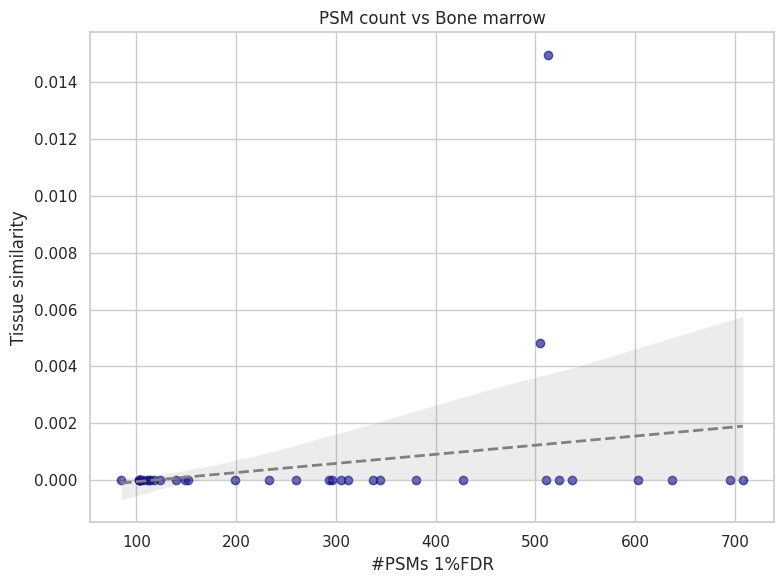

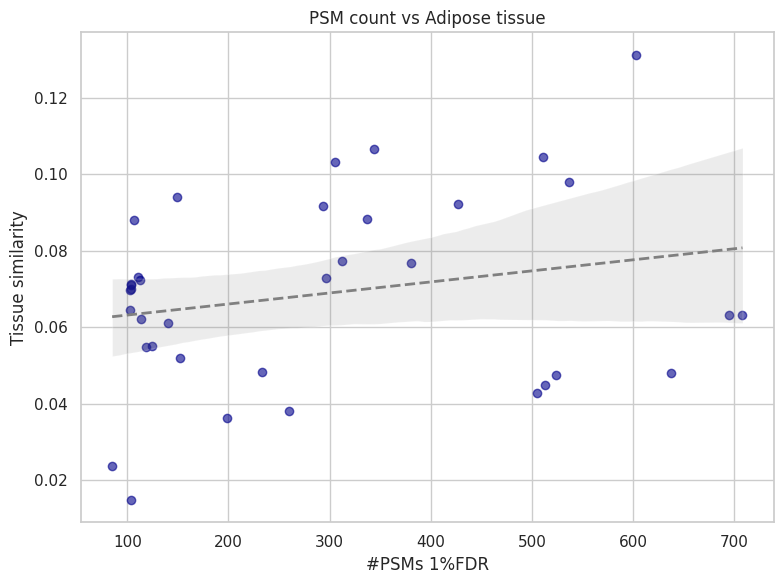

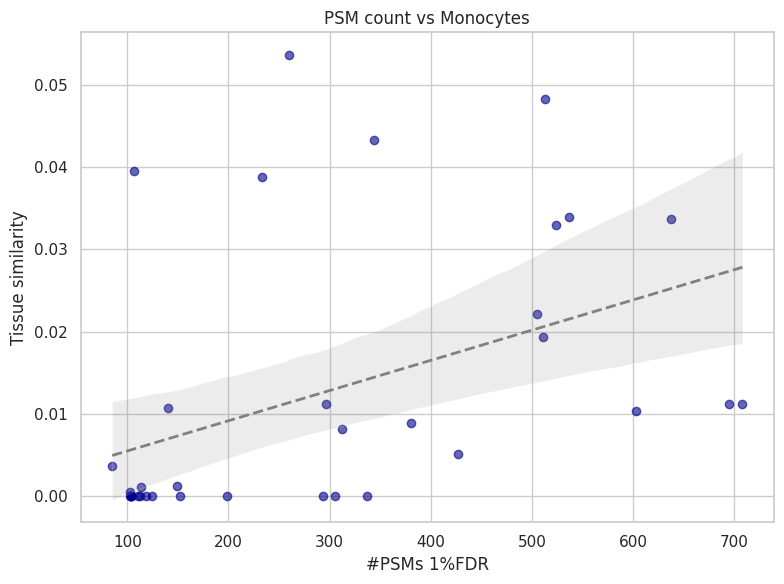

In [7]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np

# Assuming psm_dict and unique_proteins_dict are predefined dictionaries
psm_df = pd.DataFrame(psm_dict.items(), columns=["filename", "psm_count"])
prot_df = pd.DataFrame(unique_proteins_dict.items(), columns=["filename", "unique proteins"])

# Add columns from mlmarker_df where filenames match
psm_df["Bone marrow"] = psm_df["filename"].map(mlmarker_df.set_index("filename")["Bone marrow"])
psm_df["Adipose tissue"] = psm_df["filename"].map(mlmarker_df.set_index("filename")["Adipose tissue"])
psm_df["Monocytes"] = psm_df["filename"].map(mlmarker_df.set_index("filename")["Monocytes"])
psm_df['fraction_number'] = psm_df["filename"].map(mlmarker_df.set_index("filename")["fraction_number"])

psm_df.set_index("filename", inplace=True)

# Filter out only CSF samples
psm_df = psm_df[psm_df.index.str.contains("Plasma")]

check_corr_for = ["Bone marrow", "Adipose tissue", "Monocytes"]

print(psm_df.corr())

# Scatterplot with trend line and custom legend
for tissue in check_corr_for:
    plt.figure(figsize=(8,6))
    
    # Scatter plot
    scatter = plt.scatter(x="psm_count", y=tissue, data=psm_df,  alpha=0.6, color='darkblue')
    
    # Add a trend line using seaborn's regplot for linear regression
    sns.regplot(x="psm_count", y=tissue, data=psm_df, scatter=False, ax=plt.gca(), color='grey', line_kws={"lw": 2, "ls": "--"})
    
    # Title and labels
    plt.title(f"PSM count vs {tissue}")
    plt.xlabel("#PSMs 1%FDR")
    plt.ylabel("Tissue similarity")
    

    plt.tight_layout()

    # Show the plot
    plt.show()


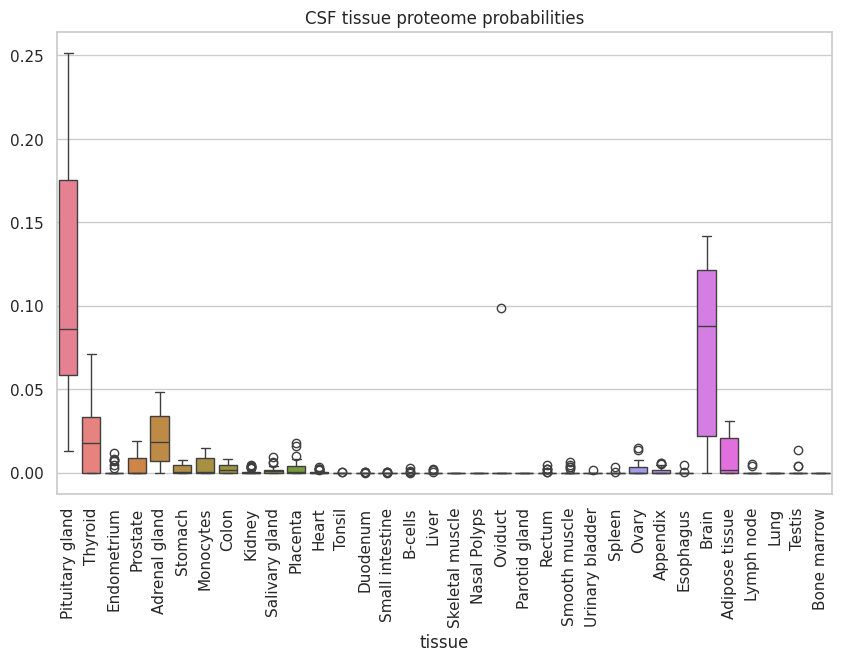

In [5]:
plt.figure(figsize=(10,6))
sns.boxplot(data=mlmarker_df[mlmarker_df['type'] == 'CSF'].iloc[:, :-2])
plt.title('CSF tissue proteome probabilities')
plt.tick_params(axis='x', rotation=90)

<Axes: xlabel='tissue'>

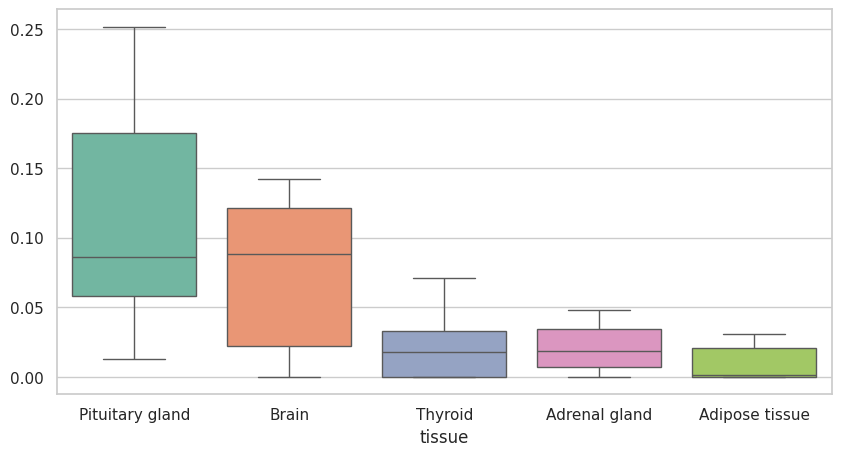

In [6]:
import seaborn as sns

# get the top 5 most probable tissue classes
top5 = mlmarker_df[mlmarker_df['type'] == 'CSF'].iloc[:, :-4].mean(axis=0).sort_values(ascending=False).head(5).index.tolist()
plt.figure(figsize=(10, 5))
sns.boxplot(data=mlmarker_df[mlmarker_df['type'] == 'CSF'][top5], palette='Set2')


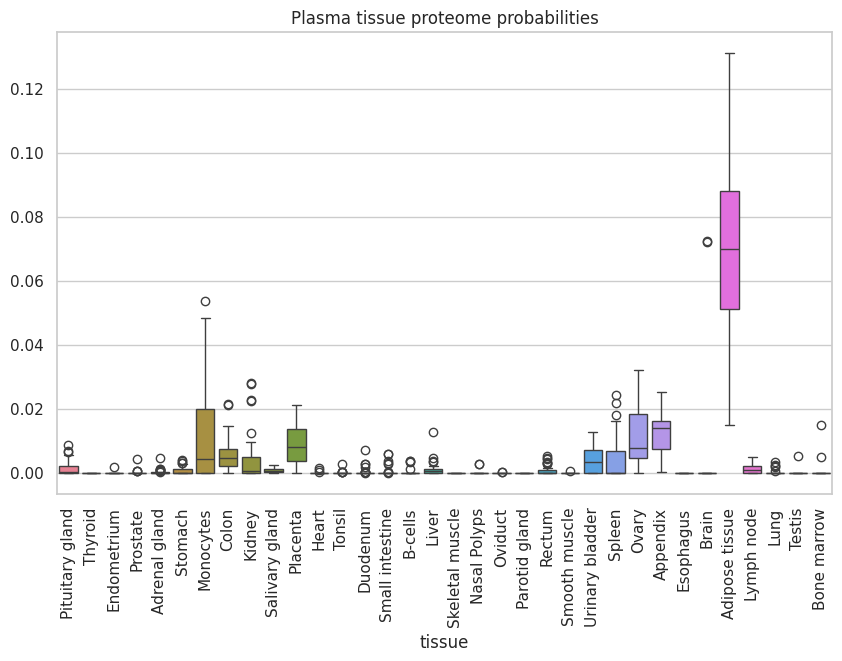

In [9]:
plt.figure(figsize=(10,6))
sns.boxplot(data=mlmarker_df[mlmarker_df['type'] == 'Plasma'].iloc[:, :-2])
plt.title('Plasma tissue proteome probabilities')
plt.tick_params(axis='x', rotation=90)

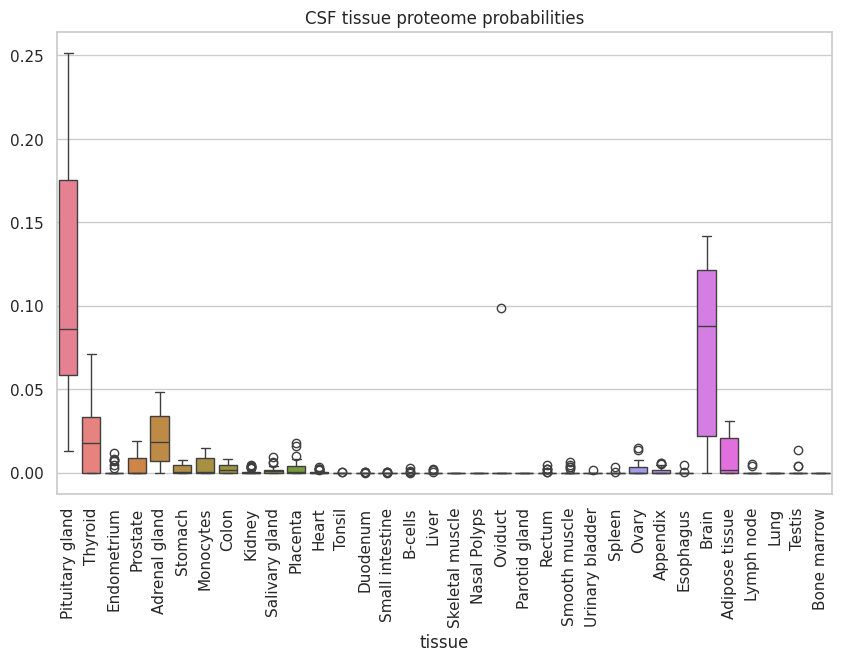

In [10]:
plt.figure(figsize=(10,6))
sns.boxplot(data=mlmarker_df[mlmarker_df['type'] == 'CSF'].iloc[:, :-2])
plt.title('CSF tissue proteome probabilities')
plt.tick_params(axis='x', rotation=90)

In [22]:
psm_df = pd.DataFrame(psm_dict.items(), columns=["filename", "psm_count"])
mlmarker_df['psm_count'] = mlmarker_df['filename'].map(psm_df.set_index("filename")["psm_count"])
mlmarker_df.head()

tissue,Pituitary gland,Thyroid,Endometrium,Prostate,Adrenal gland,Stomach,Monocytes,Colon,Kidney,Salivary gland,...,Adipose tissue,Lymph node,Lung,Testis,Bone marrow,PXD_folder,filename,type,fraction_number,psm_count
0,0.08046,0.05959,0.00764,0.00726,0.00703,0.00700,0.00607,0.00402,0.00311,0.00225,...,0.00000,0.00000,0.0,0.0,0.00000,PXD008029,CSF_OGE_Fraction_08_01.mgf.gzip,CSF,8,332
0,0.00000,0.00000,0.00000,0.00000,0.00000,0.00062,0.00000,0.00499,0.00726,0.00108,...,0.06981,0.00089,0.0,0.0,0.00000,PXD008029,Plasma_OGE_Fraction_14_02Jupiter.mgf.gzip,Plasma,14,103
0,0.17534,0.01336,0.00000,0.00000,0.04150,0.00596,0.00000,0.00000,0.00000,0.00138,...,0.00000,0.00000,0.0,0.0,0.00000,PXD008029,CSF_OGE_Fracction_02_02Jupiter.mgf.gzip,CSF,2,612
0,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.03887,0.00897,0.00000,0.00061,...,0.04827,0.00067,0.0,0.0,0.00000,PXD008029,Plasma_OGE_Fraction_07_02(Jupiter).mgf.gzip,Plasma,7,233
0,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.02211,0.00318,0.00000,0.00027,...,0.04285,0.00000,0.0,0.0,0.00483,PXD008029,Plasma_OGE_Fraction_04_02(Jupiter).mgf.gzip,Plasma,4,505


In [ ]:
#make a umap 
reducer = umap.UMAP()
x = mlmarker_df.copy().set_index('filename').drop(columns=['PXD_folder', 'fraction_number'])
embedding_pred_df = pd.DataFrame(umap_data)
embedding_pred_df['filename'] = x.index
embedding_pred_df['type'] = x.loc[:, 'type'].reset_index()['type']
embedding_pred_df['Bone marrow'] = x.loc[:, 'Bone marrow'].reset_index()['Bone marrow']
embedding_pred_df['Pituitary gland'] = x.loc[:, 'Pituitary gland'].reset_index()['Pituitary gland']

sns.scatterplot(data=embedding_pred_df, x=embedding_pred_df[0], y=embedding_pred_df[1], hue='Bone marrow', style='type', s=50, alpha=0.7, palette='crest')

plt.xlabel('UMAP Dimension 1')
plt.ylabel('UMAP Dimension 2')
plt.title('UMAP Plot of Prediction Colored by Brain similarity')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()


# The proteins that aid the Brain/pit gland predictions, are these known TLPs?

In [4]:
mlmarker_df.sort_values(by='Brain', ascending=False)[['Bone marrow', 'Pituitary gland', 'Brain', 'filename']].head()

tissue,Bone marrow,Pituitary gland,Brain,filename
0,0.0,0.17534,0.14209,CSF_OGE_Fracction_02_02Jupiter.mgf.gzip
0,0.0,0.18336,0.14175,CSF_OGE_Fracction_02_02(Jupiter).mgf.gzip
0,0.0,0.01877,0.14074,CSF_OGE_Fracction_15_02(Jupiter).mgf.gzip
0,0.0,0.20473,0.13867,CSF_OGE_Fracction_03_02(Jupiter).mgf.gzip
0,0.0,0.15451,0.12748,CSF_OGE_Fracction_10_02Jupiter.mgf.gzip


In [9]:
path = "/home/compomics/conode53_pride/PRIDE_DATA/PXD008029/IONBOT_v0.11.0/CSF_OGE_Fracction_02_02Jupiter.mgf.gzip/ionbot.first.csv"
lengths_path = "/home/compomics/git/Projects/MLMarker_paper/uniprot_reviewed_lengths.tsv"
poor_sample = pd.read_csv(path)
lenghts_df = pd.read_csv(lengths_path, sep='\t')
poor_sample_df = ionbot_first_to_prot_quant(poor_sample, lenghts_df)
data = poor_sample_df.pivot_table(columns='proteins', values='NSAF', aggfunc='sum')
data = data.fillna(0)
model = mlmarker.MLMarker(data, binary=False, dev=True, penalty_factor=1)
model.load_sample(data.iloc[0:1, :])
prediction = model.explainability.adjusted_absent_shap_values_df( n_preds=100)
mlmarker_features = prediction.columns.tolist()

Trying to unpickle estimator DecisionTreeClassifier from version 1.5.1 when using version 1.6.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
Trying to unpickle estimator RandomForestClassifier from version 1.5.1 when using version 1.6.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations


In [11]:
import plotly.graph_objects as go

def visualise_custom_tissue_plot(df, tissue_name, top_n=10, show_others=False, threshold_others = 0.001):
    df = df.loc[[tissue_name]]

    # Separate positive and negative values for the tissue
    positive_contributions = df.clip(lower=0)  # Keep only positive values
    negative_contributions = df.clip(upper=0).abs()  # Keep absolute values of negatives

    # Filter significant contributions
    positive_main = positive_contributions.loc[:, (positive_contributions > threshold_others).any()]
    positive_others = positive_contributions.loc[:, (positive_contributions <= threshold_others).all()].sum(axis=1)

    negative_main = negative_contributions.loc[:, (negative_contributions > threshold_others).any()]
    negative_others = negative_contributions.loc[:, (negative_contributions <= threshold_others).all()].sum(axis=1)

    # Sort positive and negative contributions by total value
    sorted_positive = positive_main.sum(axis=0).sort_values(ascending=False)
    sorted_negative = negative_main.sum(axis=0).sort_values(ascending=False)

    # Select top N positive and negative proteins
    top_positive_contributions = sorted_positive.head(top_n).index.tolist()
    top_negative_contributions = sorted_negative.head(top_n).index.tolist()

    # Plotting
    fig = go.Figure()

    # Add all positive contributions (green bars)
    for protein in sorted_positive.index:
        # Check if the protein is one of the top N and add its label
        is_top = protein in top_positive_contributions
        fig.add_trace(
            go.Bar(
                x=positive_contributions.index,
                y=positive_main[protein],
                name=protein,
                marker_color="green" if is_top else "darkgreen",
                hoverinfo="name+y",
                hoverlabel=dict(namelength=-1),
                showlegend=False,
                text=protein if is_top else None,  # Show label for top proteins
                textposition="outside",  # Position the label inside the bar
                cliponaxis=False,  # Allow the label to be outside the bar
            )
        )
    # Add lines for top proteins to connect labels outside the bars
    for protein in top_positive_contributions:
        fig.add_trace(
            go.Scatter(
                x=[positive_contributions.index[0], positive_contributions.index[0]],
                y=[positive_contributions[protein].min(), positive_contributions[protein].max()],
                mode="lines+text",
                line=dict(color="green", width=2, dash="dot"),  # Line connecting label to bar
                text=[protein],
                textposition="middle right",
                showlegend=False,
                textfont=dict(color="green", size=12)
            )
        )
    # Add "Others" for positive contributions
    if show_others and positive_others.sum() > 0:
        fig.add_trace(
            go.Bar(
                x=positive_contributions.index,
                y=positive_others,
                name="Others (Positive)",
                marker_color="lightgreen",
                hoverinfo="name+y",
                hoverlabel=dict(namelength=-1),
                showlegend=False,
            )
        )

  # Add negative contributions (sorted by total contribution)
    for protein in sorted_negative.index:
        is_top = protein in top_negative_contributions
        fig.add_trace(
            go.Bar(
                x=negative_contributions.index,
                y=negative_main[protein],
                name=protein,
                marker_color="red" if is_top else "darkred",
                hoverinfo="name+y",
                hoverlabel=dict(namelength=-1),
                showlegend=False,
                text=protein if is_top else None,  # Show label for top proteins
                textposition="outside",  # Position the label outside the bar
                cliponaxis=False,  # Allow the label to be outside the bar
            )
        )

    # Add "Others" for negative contributions
    if show_others and negative_others.sum() > 0:
        fig.add_trace(
            go.Bar(
                x=negative_contributions.index,
                y=negative_others,
                name="Others (Negative)",
                marker_color="lightcoral",
                hoverinfo="name+y",
                hoverlabel=dict(namelength=-1),
                showlegend=False,
            )
        )

    # Customizing layout
    fig.update_layout(
        barmode="stack",  # Stack the bars
        title=f"""Protein Contributions for {tissue_name} (threshold={threshold_others})<br> 
        total probability = {df.loc[tissue_name].sum()}""",
        xaxis_title="Cluster",
        yaxis_title="Protein Contributions",
        xaxis={"categoryorder": "array", "categoryarray": sorted_positive.index.tolist() + sorted_negative.index.tolist()},
        hovermode="closest",
        template="plotly_white",
        width=600,
        height=800,
        margin=dict(l=100, r=100),  # Adjust margins
    )
    fig.show()


In [12]:
visualise_custom_tissue_plot(prediction, tissue_name='Brain', show_others=False, threshold_others = 0.001) 

In [ ]:
import bioservices
u = bioservices.UniProt()

def get_protein_info(protein_id):
    """
    Get protein information from UniProt.
    
    Parameters:
        protein_id (str): UniProt protein ID.
    
    Returns:
        dict: Protein information.
    """
    try:
        protein_info = u.search(protein_id, columns="accession, id, protein_name, cc_tissue_specificity")
        protein_info = protein_info.split('\n')[1].split('\t')
        protein_dict = {
            'id': protein_info[0],
            'entry name': protein_info[1],
            'protein_names': protein_info[2]
        }
        if len(protein_info) == 4:
            protein_dict['tissue_specificity'] = protein_info[3]
        return protein_dict
    except:
        print(f"Error retrieving information for protein {protein_id}")
        return None


In [ ]:
protein_info_list = []
for i in prediction.loc['Brain'].sort_values(ascending=False).head(10).index:
    protein_info = get_protein_info(i)
    if protein_info is not None:
        protein_info_list.append(protein_info)

df = pd.DataFrame(protein_info_list)
df

,id,entry name,protein_names,tissue_specificity
0,Q96GW7,PGCB_HUMAN,Brevican core protein (Brain-enriched hyaluron...,"TISSUE SPECIFICITY: Expressed in the retina, s..."
1,Q12860,CNTN1_HUMAN,Contactin-1 (Glycoprotein gp135) (Neural cell ...,TISSUE SPECIFICITY: Strongly expressed in brai...
2,O14594,NCAN_HUMAN,Neurocan core protein (Chondroitin sulfate pro...,TISSUE SPECIFICITY: Detected in cerebrospinal ...
3,Q8N3J6,CADM2_HUMAN,Cell adhesion molecule 2 (Immunoglobulin super...,NaN
4,O15240,VGF_HUMAN,Neurosecretory protein VGF [Cleaved into: Neur...,TISSUE SPECIFICITY: Central and peripheral ner...
5,P16519,NEC2_HUMAN,Neuroendocrine convertase 2 (NEC 2) (EC 3.4.21...,NaN
6,Q14982,OPCM_HUMAN,Opioid-binding protein/cell adhesion molecule ...,NaN
7,P54868,HMCS2_HUMAN,"Hydroxymethylglutaryl-CoA synthase, mitochondr...",TISSUE SPECIFICITY: Expression in liver is 200...
8,P19013,K2C4_HUMAN,"Keratin, type II cytoskeletal 4 (Cytokeratin-4...",TISSUE SPECIFICITY: Detected in the suprabasal...
9,P07101,TY3H_HUMAN,Tyrosine 3-monooxygenase (EC 1.14.16.2) (Tyros...,TISSUE SPECIFICITY: Mainly expressed in the br...


P54868 Hydroxymethylglutaryl-CoA synthase in uniprot not in the brain but here marked as brain specific! literature supported   
Q8N3J6 Cell adhesion molecule 2 is brain specific according to HPA   
Q9HD89 Resistin is according to uniprot mostly in bone depending on the isoform also in brain, brain detection supported by literature as well

In [49]:
palette = sns.color_palette("Set2")
palette_for_plotly = [f"rgb({c[0]*256}, {c[1]*256}, {c[2]*256})" for c in palette]

def prediction_df_2tissues_scatterplot(df, tissues=list):
    tissueA = tissues[0]
    tissueB = tissues[1]
    df_vis = df.T

    fig = go.Figure(data=go.Scatter(
        x=df_vis[tissueA],
        y=df_vis[tissueB],
        mode='markers',
        marker=dict(
            size=8,
            color=palette_for_plotly[1],
            opacity=0.7
        ),
        text=[f"Protein: {protein}<br>{tissueA} SHAP: {pg_shap}<br>{tissueB} value: {brain_value}" 
            for protein, pg_shap, brain_value in zip(df_vis.index, df_vis[tissueA], df_vis[tissueB])],
        hoverinfo='text'
    ))

    fig.update_layout(
        title=f'Scatterplot of {tissueA} SHAP values vs {tissueB} values',
        xaxis_title=f'{tissueA} SHAP values',
        yaxis_title=f'{tissueB} SHAP values',
        xaxis=dict(color='black', zeroline=True, zerolinecolor='darkgrey'),
        yaxis=dict(color='black', zeroline=True, zerolinecolor='darkgrey'),
        width=800,  # BEGIN: Set width
        height=600  # Set height
    )
    #set width and height
    

    return fig
fig = prediction_df_2tissues_scatterplot(prediction, tissues=['Brain', 'Pituitary gland'])
#save fig with high dpi
fig.write_image("/home/compomics/git/Projects/MLMarker_paper/PXD008029_CSF/scatterplot_poster.png", width=800, height=600, scale=5)
fig.show()

In [52]:
palette = sns.color_palette("Set2")
palette_for_plotly = [f"rgb({c[0]*256}, {c[1]*256}, {c[2]*256})" for c in palette]

def visualise_custom_plot(df):
        
    # Aggregate positive and negative contributions per tissue
    positive_totals = df.clip(lower=0).sum(axis=1)
    negative_totals = df.clip(upper=0).abs().sum(axis=1)

    # Create the figure
    fig = go.Figure()

    # Add positive contributions (green bars)
    fig.add_trace(
        go.Bar(
            x=df.index,
            y=positive_totals,
            name="Positive Contributions",
            marker_color=palette_for_plotly[0],
            hoverinfo='x+y',
        )
    )

    # Add negative contributions (red bars)
    fig.add_trace(
        go.Bar(
            x=df.index,
            y=negative_totals,
            name="Negative Contributions",
            marker_color=palette_for_plotly[1],
            hoverinfo='x+y',
        )
    )

    # Customizing layout
    fig.update_layout(
        barmode='group',  # Group positive and negative bars side-by-side
        title='Grouped Barplot of Total Protein Contributions by Tissue',
        xaxis_title='Tissues',
        yaxis_title='Total Contributions',
        xaxis=dict(tickangle=-45),  # Tilt the x-axis labels for better readability
        template="plotly_white",
        width=1600,  # BEGIN: Set width
        height=600  # Set height
    )

    return fig
fig = visualise_custom_plot(prediction)
fig.write_image("/home/compomics/git/Projects/MLMarker_paper/PXD008029_CSF/predictions_poster.png", width=1600, height=600, scale=5)
fig.show()

In [87]:
from mlmarker.explainability import get_protein_info
path = "/home/compomics/conode53_pride/PRIDE_DATA/PXD008029/IONBOT_v0.11.0/CSF_OGE_Fracction_02_02Jupiter.mgf.gzip/ionbot.first.csv"
lengths_path = "/home/compomics/git/Projects/MLMarker_paper/uniprot_reviewed_lengths.tsv"
tissue_to_study="Bone marrow"
poor_sample = pd.read_csv(path)
lenghts_df = pd.read_csv(lengths_path, sep='\t')
poor_sample_df = ionbot_first_to_prot_quant(poor_sample, lenghts_df)
data = poor_sample_df.pivot_table(columns='proteins', values='NSAF', aggfunc='sum')
data = data.fillna(0)
model = mlmarker.MLMarker(binary=False, dev=True, penalty_factor=1)
model.load_sample(data.iloc[0:1, :])
prediction = model.explainability.adjusted_absent_shap_values_df( n_preds=100)

pd.set_option('display.max_colwidth', None)
visualise_custom_plot(prediction)
visualise_custom_tissue_plot(prediction, tissue_name=tissue_to_study, show_others=False, threshold_others = 0.001) 
top10_cont = prediction.loc[tissue_to_study].sort_values().tail(20).index.tolist()
top10_info_cont = []
top10_hpa_cont = []
for i in top10_cont:
    print(i)
    top10_info_cont.append(get_protein_info(i))
    top10_hpa_cont.append(get_hpa_info(i))
pd.DataFrame(top10_info_cont)
shaps = pd.DataFrame(prediction.loc[tissue_to_study][top10_cont].reset_index())
shaps.rename(columns={tissue_to_study: 'value'}, inplace=True)

P08575
P04040
P62328
O75165
O75367
P80723
P05109
P25815
P00338
O00160
Q9HD89
P05204
O94804
Q9Y490
P02549
Q32MZ4
P06702
P13796
Q7Z6P3
P11678


In [86]:
# Assuming top10_hpa_notcont is a list of DataFrames
combined_hpa_df = pd.concat(top10_hpa_cont, ignore_index=True)
combined_hpa_df = combined_hpa_df[['Uniprot', 'RNA tissue specific nTPM', 'Tissue expression cluster']]
combined_hpa_df = pd.merge(combined_hpa_df, pd.DataFrame(top10_info_cont), left_on='Uniprot', right_on='id')
combined_hpa_df = pd.merge(combined_hpa_df, shaps, left_on='Uniprot', right_on='index')
combined_hpa_df.drop(columns=['id', 'index'], inplace=True)
combined_hpa_df.sort_values(by='value', ascending=False)
combined_hpa_df.to_csv(f"{tissue_to_study}_top 20 positive predicting proteins.csv")



In [55]:
def get_protein_info(protein_id):
    """
    Get protein information from UniProt.
    
    Parameters:
        protein_id (str): UniProt protein ID.
    
    Returns:
        dict: Protein information.
    """
    import bioservices
    u = bioservices.UniProt()
    try:
        protein_info = u.search(protein_id, columns="accession, id, protein_name, cc_tissue_specificity")
        protein_info = protein_info.split('\n')[1].split('\t')
        protein_dict = {
            'id': protein_info[0],
            'entry name': protein_info[1],
            'protein_names': protein_info[2]
        }
        if len(protein_info) == 4:
            protein_dict['tissue_specificity'] = protein_info[3]
        return protein_dict
    except:
        print(f"Error retrieving information for protein {protein_id}")
        return None
import requests

from io import StringIO
def get_hpa_info(protein_id):
    url = f"https://www.proteinatlas.org/api/search_download.php?search={protein_id}&format=tsv&columns=up,rnatsm,rnabcs,rnabcd,rnabcss,rnabcsm,rnabls,rnabld,rnablss,rnablsmecblood,ectissue,blconcms&compress=no"
    response = requests.get(url)
    df = pd.read_csv(StringIO(response.text), sep='\t')
    return df


What proteins impact adipose tissue prediction?

In [ ]:
CSF
pxd = "PXD008029"
base_path = f"/home/compomics/conode*/PRIDE_DATA/"  
lengths_path = "/home/compomics/git/Projects/MLMarker_paper/uniprot_reviewed_lengths.tsv"
mlmarker_protein_df, unique_proteins_dict, psm_dict = get_mlmarker_dataframe(pxd, base_path, lengths_path, dev=True, tissue_level=False, count_psms=True)
mlmarker_protein_df.iloc[:,:-2] = mlmarker_protein_df.iloc[:,:-2].clip(lower=0)
mlmarker_protein_df.head()
mlmarker_protein_df.shape

In [56]:
mlmarker_protein_df['type'] = mlmarker_protein_df['filename'].str.split('_').str[0]
plasma_analysis = mlmarker_protein_df[mlmarker_protein_df['type'] == 'Plasma']

In [57]:
plasma_analysis = plasma_analysis[['Monocytes', 'type']]
plasma_analysis = plasma_analysis[plasma_analysis['Monocytes']>0].reset_index()
plasma_analysis

tissue,index,Monocytes,type
0,A0A075B6S5,0.00002,Plasma
1,A6NMZ7,0.00001,Plasma
2,A8K7I4,0.00001,Plasma
3,O00204,0.00001,Plasma
4,O00763,0.00002,Plasma
...,...,...,...
9656,Q9Y336,0.00012,Plasma
9657,Q9Y3Q3,0.00001,Plasma
9658,Q9Y4B6,0.00003,Plasma
9659,Q9Y5Y6,0.00002,Plasma


Index(['P61626', 'P98160', 'P40197', 'P52907', 'Q9NZN4', 'P08567', 'O00754',
       'P08571', 'P28070', 'P51884', 'Q9NUQ9', 'P30050', 'P30520', 'P02775',
       'Q15120', 'Q9Y295', 'P55268', 'Q14204', 'P02549', 'P00488', 'P07996',
       'P08514', 'Q9BUF5', 'Q562R1', 'P27824'],
      dtype='object', name='index')

In [58]:
for i in plasma_analysis.groupby('index')['Monocytes'].mean().sort_values(ascending=False).to_frame().head(25).index:
    print(get_protein_info(i))

{'id': 'P61626', 'entry name': 'LYSC_HUMAN', 'protein_names': 'Lysozyme C (EC 3.2.1.17) (1,4-beta-N-acetylmuramidase C)'}
{'id': 'P98160', 'entry name': 'PGBM_HUMAN', 'protein_names': 'Basement membrane-specific heparan sulfate proteoglycan core protein (HSPG) (Perlecan) (PLC) [Cleaved into: Endorepellin; LG3 peptide]', 'tissue_specificity': 'TISSUE SPECIFICITY: Detected in cerebrospinal fluid, fibroblasts and urine (at protein level). {ECO:0000269|PubMed:25326458, ECO:0000269|PubMed:36213313}.'}
{'id': 'P40197', 'entry name': 'GPV_HUMAN', 'protein_names': 'Platelet glycoprotein V (GPV) (Glycoprotein 5) (CD antigen CD42d)', 'tissue_specificity': 'TISSUE SPECIFICITY: Platelets and megakaryocytes.'}
{'id': 'P52907', 'entry name': 'CAZA1_HUMAN', 'protein_names': 'F-actin-capping protein subunit alpha-1 (CapZ alpha-1)'}
{'id': 'Q9NZN4', 'entry name': 'EHD2_HUMAN', 'protein_names': 'EH domain-containing protein 2 (PAST homolog 2)', 'tissue_specificity': 'TISSUE SPECIFICITY: Highly expressed